In [1]:
from attention_visualization_utils import *

pretrained_weights256 = '../Checkpoints/vit256_small_dino.pth'
pretrained_weights4k = '../Checkpoints/vit4k_xs_dino.pth'
model256 = get_vit256(pretrained_weights=pretrained_weights256)
model4k = get_vit4k(pretrained_weights=pretrained_weights4k)
light_jet = cmap_map(lambda x: x/2 + 0.5, matplotlib.cm.jet)

/home/richard/anaconda3/envs/tiatools/lib/python3.9/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Take key teacher in provided checkpoint dict
Pretrained weights found at ../Checkpoints/vit256_small_dino.pth and loaded with msg: _IncompatibleKeys(missing_keys=[], unexpected_keys=['head.mlp.0.weight', 'head.mlp.0.bias', 'head.mlp.2.weight', 'head.mlp.2.bias', 'head.mlp.4.weight', 'head.mlp.4.bias', 'head.last_layer.weight_g', 'head.last_layer.weight_v'])
# of Patches: 196
Take key teacher in provided checkpoint dict
Pretrained weights found at ../Checkpoints/vit4k_xs_dino.pth and loaded with msg: _IncompatibleKeys(missing_keys=[], unexpected_keys=['head.mlp.0.weight', 'head.mlp.0.bias', 'head.mlp.2.weight', 'head.mlp.2.bias', 'head.mlp.4.weight', 'head.mlp.4.bias', 'head.last_layer.weight_g', 'head.last_layer.weight_v'])


### 256 Demo (Individual)

In [2]:
patch = Image.open('./image_demo/image_256.png')
output_dir = './attention_demo/256_output_indiv/'
os.makedirs(output_dir, exist_ok=True)
create_patch_heatmaps_indiv(patch, model256, output_dir, 'patch', threshold=0.5, cmap=light_jet)

/home/richard/anaconda3/envs/tiatools/lib/python3.9/site-packages/torch/nn/functional.py:3631: UserWarning: Default upsampling behavior when mode=bicubic is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  warnings.warn(
/home/richard/anaconda3/envs/tiatools/lib/python3.9/site-packages/torch/nn/functional.py:3679: UserWarning: The default behavior for interpolate/upsample with float scale_factor changed in 1.6.0 to align with other frameworks/libraries, and now uses scale_factor directly, instead of relying on the computed output size. If you wish to restore the old behavior, please set recompute_scale_factor=True. See the documentation of nn.Upsample for details. 
  warnings.warn(


### 256 Demo (Concatenated)

In [9]:
patch = Image.open('./image_demo/image_256.png')
output_dir = './attention_demo/256_output_concat/'
os.makedirs(output_dir, exist_ok=True)
create_patch_heatmaps_concat(patch, model256, output_dir, 'patch', cmap=light_jet)

### 4K Demo (Saves Heatmaps Individually)

In [11]:
region = Image.open('./image_demo/image_4k.png')
output_dir = './attention_demo/4k_output_indiv/'
os.makedirs(output_dir, exist_ok=True)
create_hierarchical_heatmaps_indiv(region, model256, model4k, output_dir, slide_id, 
                                 scale=2, threshold=0.5, cmap=light_jet, alpha=0.5)

/home/richard/anaconda3/envs/tiatools/lib/python3.9/site-packages/torch/nn/functional.py:3631: UserWarning: Default upsampling behavior when mode=bicubic is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  warnings.warn(
/home/richard/anaconda3/envs/tiatools/lib/python3.9/site-packages/torch/nn/functional.py:3679: UserWarning: The default behavior for interpolate/upsample with float scale_factor changed in 1.6.0 to align with other frameworks/libraries, and now uses scale_factor directly, instead of relying on the computed output size. If you wish to restore the old behavior, please set recompute_scale_factor=True. See the documentation of nn.Upsample for details. 
  warnings.warn(


### 4K Demo (Saves Heatmaps Concatenated)

In [19]:
region = Image.open('./image_demo/image_4k.png')
output_dir = './attention_demo/4k_output_concat/'
os.makedirs(output_dir, exist_ok=True)

create_hierarchical_heatmaps_concat(region, model256, model4k, output_dir, slide_id, 
                                 scale=4, cmap=light_jet, alpha=0.5)

##

In [9]:
dataroot = '/media/hdd1/hipt_maps/'
slide_id = 'TCGA-55-8508-01Z-00-DX1.96B173E2-A298-4017-9AEC-113E547A3272'
dataset = wds.WebDataset([os.path.join(dataroot, '%s.tar' % slide_id)]).decode('pil').to_tuple("jpg", 'mask.pyd').map_tuple(transforms.PILToTensor(), identity)
loader = wds.WebLoader(dataset, batch_size=1, num_workers=4)
output_dir = '/media/hdd1/hipt_maps/concat/'
os.makedirs(output_dir, exist_ok=True)

for count, web in tqdm(enumerate(loader)):
    region = Image.fromarray(np.transpose(web[0][0].cpu().numpy(), (1,2,0)))
    break

0it [00:00, ?it/s]/home/mahmoodlab/anaconda3/envs/clam/lib/python3.7/site-packages/webdataset/dataset.py:139: UserWarning: num_workers 4 > num_shards 1
  warnings.warn(f"num_workers {num_workers} > num_shards {len(urls)}")
/home/mahmoodlab/anaconda3/envs/clam/lib/python3.7/site-packages/torchvision/transforms/functional.py:109: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /opt/conda/conda-bld/pytorch_1595629403081/work/torch/csrc/utils/tensor_numpy.cpp:141.)
  img = torch.as_tensor(np.asarray(pic))
0it [00:00, ?it/s]


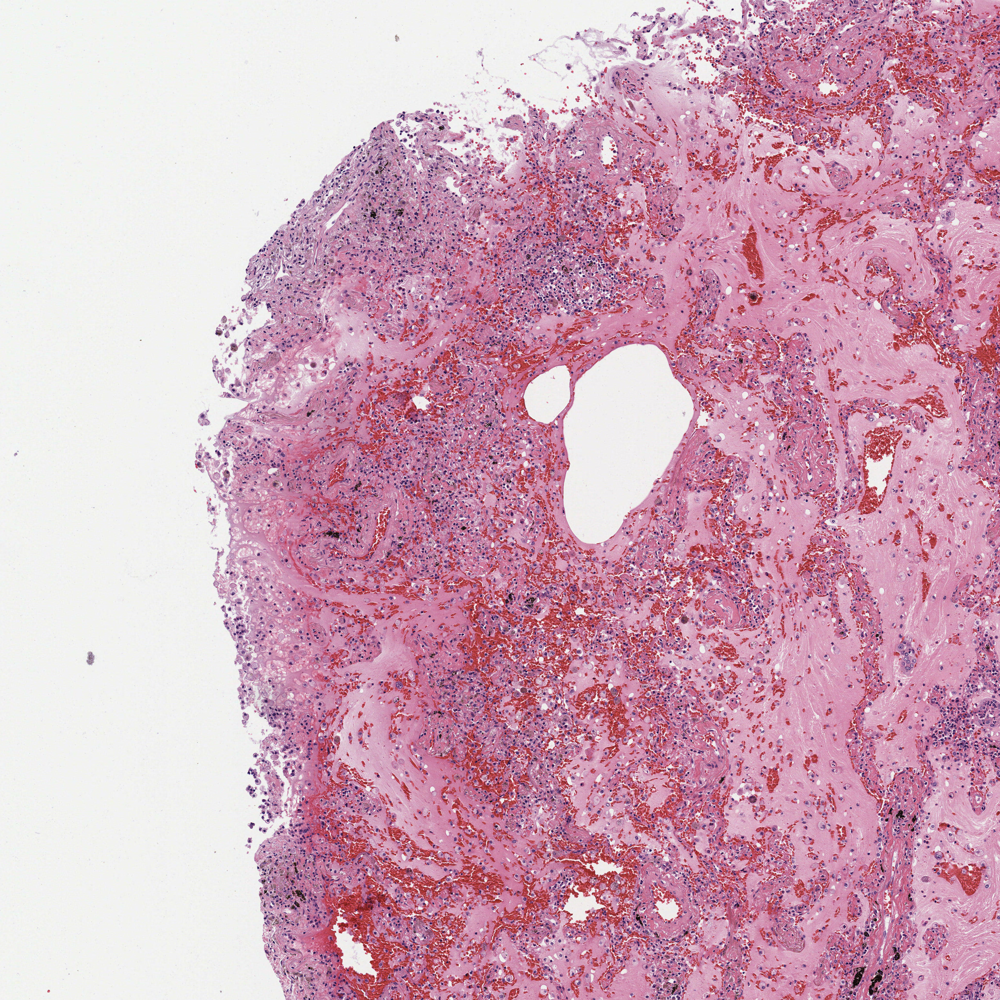

In [23]:
region

tensor([[[[244, 244, 244,  ..., 234, 242, 232],
          [244, 243, 244,  ..., 235, 238, 230],
          [242, 243, 243,  ..., 226, 211, 218],
          ...,
          [245, 244, 241,  ..., 221, 206, 207],
          [245, 244, 242,  ..., 183, 172, 215],
          [245, 244, 242,  ..., 213, 204, 239]],

         [[245, 245, 245,  ..., 203, 214, 205],
          [244, 244, 245,  ..., 201, 205, 199],
          [243, 244, 244,  ..., 189, 177, 185],
          ...,
          [244, 242, 239,  ..., 192, 181, 185],
          [243, 242, 240,  ..., 146, 136, 180],
          [242, 241, 241,  ..., 170, 159, 195]],

         [[249, 247, 247,  ..., 219, 229, 222],
          [246, 246, 247,  ..., 218, 222, 215],
          [245, 246, 246,  ..., 207, 194, 202],
          ...,
          [242, 243, 240,  ..., 222, 203, 197],
          [246, 245, 243,  ..., 180, 164, 202],
          [249, 248, 246,  ..., 200, 188, 220]]]], dtype=torch.uint8)

### Select WSI Attention Maps

In [6]:
dataroot = '/media/hdd1/hipt_maps/'
slide_id = 'TCGA-NH-A50U-01Z-00-DX1.CA30EE72-7149-44E0-9082-AC1922ADDB09'
dataset = wds.WebDataset([os.path.join(dataroot, '%s.tar' % slide_id)]).decode('pil').to_tuple("jpg", 'mask.pyd').map_tuple(transforms.PILToTensor(), identity)
loader = wds.WebLoader(dataset, batch_size=1, num_workers=4)
output_dir = '/media/hdd2/hipt_maps/concat/'
os.makedirs(output_dir, exist_ok=True)

for count, web in tqdm(enumerate(loader)):
    region = Image.fromarray(np.transpose(web[0][0].cpu().numpy(), (1,2,0)))
    patch_masks = web[1][0].to(torch.long).cpu().numpy()
    output_subdir = os.path.join(output_dir, slide_id, '%s_%d' % (slide_id, count))
    os.makedirs(output_subdir, exist_ok=True)
    region.resize((4096, 4096)).save(os.path.join(output_subdir, '%s_%d.png' % (slide_id, count)))
    create_hierarchical_heatmaps_concat(region, model256, model4k, output_subdir, '%s_%d' % (slide_id, count), 
                                 scale=4, cmap=light_jet, alpha=0.5)

0it [00:00, ?it/s]/home/mahmoodlab/anaconda3/envs/clam/lib/python3.7/site-packages/webdataset/dataset.py:139: UserWarning: num_workers 4 > num_shards 1
  warnings.warn(f"num_workers {num_workers} > num_shards {len(urls)}")
/home/mahmoodlab/anaconda3/envs/clam/lib/python3.7/site-packages/torchvision/transforms/functional.py:109: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /opt/conda/conda-bld/pytorch_1595629403081/work/torch/csrc/utils/tensor_numpy.cpp:141.)
  img = torch.as_tensor(np.asarray(pic))
61it [42:31, 41.83s/it]


In [70]:
dataroot = '/media/hdd2/hipt_maps/'
slide_id = 'TCGA-NH-A50U-01Z-00-DX1.CA30EE72-7149-44E0-9082-AC1922ADDB09'
dataset = wds.WebDataset([os.path.join(dataroot, '%s.tar' % slide_id)]).decode('pil').to_tuple("jpg", 'mask.pyd').map_tuple(transforms.PILToTensor(), identity)
loader = wds.WebLoader(dataset, batch_size=1, num_workers=4)
output_dir = '/media/hdd2/hipt_maps/concat3/'
os.makedirs(output_dir, exist_ok=True)
#best = [14, 23, 46, 51, 60, 74]
best = [34]#28, 30]

for count, web in tqdm(enumerate(loader)):
    if count not in best: continue
    region = Image.fromarray(np.transpose(web[0][0].cpu().numpy(), (1,2,0)))
    patch_masks = web[1][0].to(torch.long).cpu().numpy()
    output_subdir = output_dir
    create_hierarchical_heatmaps_concat3(region, model256, model4k, output_subdir, '%s_%d' % (slide_id, count), 
                                 scale=4, cmap=light_jet, alpha=0.5)

0it [00:00, ?it/s]/home/mahmoodlab/anaconda3/envs/clam/lib/python3.7/site-packages/webdataset/dataset.py:139: UserWarning: num_workers 4 > num_shards 1
  warnings.warn(f"num_workers {num_workers} > num_shards {len(urls)}")
/home/mahmoodlab/anaconda3/envs/clam/lib/python3.7/site-packages/torchvision/transforms/functional.py:109: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /opt/conda/conda-bld/pytorch_1595629403081/work/torch/csrc/utils/tensor_numpy.cpp:141.)
  img = torch.as_tensor(np.asarray(pic))
61it [00:26,  2.30it/s]


In [7]:
dataroot = '/media/hdd2/hipt_maps/'
slide_id = 'TCGA-A2-A0CU-01Z-00-DX1.5B77D21C-A497-478B-9752-3730322AD9ED'
dataset = wds.WebDataset([os.path.join(dataroot, '%s.tar' % slide_id)]).decode('pil').to_tuple("jpg", 'mask.pyd').map_tuple(transforms.PILToTensor(), identity)
loader = wds.WebLoader(dataset, batch_size=1, num_workers=4)
output_dir = '/media/hdd2/hipt_maps/concat/'
os.makedirs(output_dir, exist_ok=True)

for count, web in tqdm(enumerate(loader)):
    region = Image.fromarray(np.transpose(web[0][0].cpu().numpy(), (1,2,0)))
    patch_masks = web[1][0].to(torch.long).cpu().numpy()
    output_subdir = os.path.join(output_dir, slide_id, '%s_%d' % (slide_id, count))
    os.makedirs(output_subdir, exist_ok=True)
    region.resize((4096, 4096)).save(os.path.join(output_subdir, '%s_%d.png' % (slide_id, count)))
    create_hierarchical_heatmaps_concat(region, model256, model4k, output_subdir, '%s_%d' % (slide_id, count), 
                                 scale=4, cmap=light_jet, alpha=0.5)

0it [00:00, ?it/s]/home/mahmoodlab/anaconda3/envs/clam/lib/python3.7/site-packages/webdataset/dataset.py:139: UserWarning: num_workers 4 > num_shards 1
  warnings.warn(f"num_workers {num_workers} > num_shards {len(urls)}")
/home/mahmoodlab/anaconda3/envs/clam/lib/python3.7/site-packages/torchvision/transforms/functional.py:109: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /opt/conda/conda-bld/pytorch_1595629403081/work/torch/csrc/utils/tensor_numpy.cpp:141.)
  img = torch.as_tensor(np.asarray(pic))
108it [1:24:58, 47.21s/it]


In [66]:
dataroot = '/media/hdd2/hipt_maps/'
slide_id = 'TCGA-A2-A0CU-01Z-00-DX1.5B77D21C-A497-478B-9752-3730322AD9ED'
dataset = wds.WebDataset([os.path.join(dataroot, '%s.tar' % slide_id)]).decode('pil').to_tuple("jpg", 'mask.pyd').map_tuple(transforms.PILToTensor(), identity)
loader = wds.WebLoader(dataset, batch_size=1, num_workers=4)
output_dir = '/media/hdd2/hipt_maps/concat3/'
os.makedirs(output_dir, exist_ok=True)

#best = [12, 8, 19, 25, 26, 35, 36, 41, 54, 66, 71]
best = [12, 17, 28, 36, 53, 74, 75, 76, 77, 78,]
for count, web in tqdm(enumerate(loader)):
    if count not in best: continue
    region = Image.fromarray(np.transpose(web[0][0].cpu().numpy(), (1,2,0)))
    patch_masks = web[1][0].to(torch.long).cpu().numpy()
    output_subdir = output_dir
    create_hierarchical_heatmaps_concat3(region, model256, model4k, output_subdir, '%s_%d' % (slide_id, count), 
                                 scale=4, cmap=light_jet, alpha=0.5)

/home/mahmoodlab/anaconda3/envs/clam/lib/python3.7/site-packages/webdataset/dataset.py:139: UserWarning: num_workers 4 > num_shards 1
  warnings.warn(f"num_workers {num_workers} > num_shards {len(urls)}")
0it [00:00, ?it/s]/home/mahmoodlab/anaconda3/envs/clam/lib/python3.7/site-packages/torchvision/transforms/functional.py:109: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /opt/conda/conda-bld/pytorch_1595629403081/work/torch/csrc/utils/tensor_numpy.cpp:141.)
  img = torch.as_tensor(np.asarray(pic))
108it [01:40,  1.08it/s]


In [ ]:
dataroot = '/media/hdd2/hipt_maps/'
slide_id = 'TCGA-A2-A0CU-01Z-00-DX1.5B77D21C-A497-478B-9752-3730322AD9ED'
dataset = wds.WebDataset([os.path.join(dataroot, '%s.tar' % slide_id)]).decode('pil').to_tuple("jpg", 'mask.pyd').map_tuple(transforms.PILToTensor(), identity)
loader = wds.WebLoader(dataset, batch_size=1, num_workers=4)
output_dir = '/media/hdd2/hipt_maps/indiv/'
os.makedirs(output_dir, exist_ok=True)

for count, web in tqdm(enumerate(loader)):
    region = Image.fromarray(np.transpose(web[0][0].cpu().numpy(), (1,2,0)))
    patch_masks = web[1][0].to(torch.long).cpu().numpy()
    output_subdir = os.path.join(output_dir, slide_id, '%s_%d' % (slide_id, count))
    os.makedirs(output_subdir, exist_ok=True)
    region.resize((4096, 4096)).save(os.path.join(output_subdir, '%s_%d.png' % (slide_id, count)))
    create_hierarchical_heatmaps_indiv(region, model256, model4k, output_subdir, '%s_%d' % (slide_id, count), 
                                 scale=2, cmap=light_jet, alpha=0.5)

In [43]:
dataroot = '/media/hdd2/hipt_maps/'
slide_id = 'TCGA-55-8508-01Z-00-DX1.96B173E2-A298-4017-9AEC-113E547A3272'
dataset = wds.WebDataset([os.path.join(dataroot, '%s.tar' % slide_id)]).decode('pil').to_tuple("jpg", 'mask.pyd').map_tuple(transforms.PILToTensor(), identity)
loader = wds.WebLoader(dataset, batch_size=1, num_workers=4)
output_dir = '/media/hdd2/hipt_maps/concat/'
os.makedirs(output_dir, exist_ok=True)

for count, web in tqdm(enumerate(loader)):
    region = Image.fromarray(np.transpose(web[0][0].cpu().numpy(), (1,2,0)))
    patch_masks = web[1][0].to(torch.long).cpu().numpy()
    output_subdir = os.path.join(output_dir, slide_id, '%s_%d' % (slide_id, count))
    os.makedirs(output_subdir, exist_ok=True)
    region.resize((4096, 4096)).save(os.path.join(output_subdir, '%s_%d.png' % (slide_id, count)))
    create_hierarchical_heatmaps_concat(region, model256, model4k, output_subdir, '%s_%d' % (slide_id, count), 
                                 scale=4, cmap=light_jet, alpha=0.5)

/home/mahmoodlab/anaconda3/envs/clam/lib/python3.7/site-packages/webdataset/dataset.py:139: UserWarning: num_workers 4 > num_shards 1
  warnings.warn(f"num_workers {num_workers} > num_shards {len(urls)}")
0it [00:00, ?it/s]/home/mahmoodlab/anaconda3/envs/clam/lib/python3.7/site-packages/torchvision/transforms/functional.py:109: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /opt/conda/conda-bld/pytorch_1595629403081/work/torch/csrc/utils/tensor_numpy.cpp:141.)
  img = torch.as_tensor(np.asarray(pic))
48it [39:05, 48.87s/it]


In [76]:
dataroot = '/media/hdd2/hipt_maps/'
slide_id = 'TCGA-93-8067-01Z-00-DX1.325d0cd5-9bb5-4f51-a197-75d3c3d19aaf'
dataset = wds.WebDataset([os.path.join(dataroot, '%s.tar' % slide_id)]).decode('pil').to_tuple("jpg").map_tuple(transforms.PILToTensor())
loader = wds.WebLoader(dataset, batch_size=1, num_workers=4)
output_dir = '/media/hdd2/hipt_maps/concat3/'
os.makedirs(output_dir, exist_ok=True)

for count, web in tqdm(enumerate(loader)):
    region = Image.fromarray(np.transpose(web[0][0].cpu().numpy(), (1,2,0)))
    #patch_masks = web[1][0].to(torch.long).cpu().numpy()
    output_subdir = output_dir
    create_hierarchical_heatmaps_concat3(region, model256, model4k, output_subdir, '%s_%d' % (slide_id, count), 
                                 scale=4, cmap=light_jet, alpha=0.5)

0it [00:00, ?it/s]/home/mahmoodlab/anaconda3/envs/clam/lib/python3.7/site-packages/webdataset/dataset.py:139: UserWarning: num_workers 4 > num_shards 1
  warnings.warn(f"num_workers {num_workers} > num_shards {len(urls)}")
/home/mahmoodlab/anaconda3/envs/clam/lib/python3.7/site-packages/torchvision/transforms/functional.py:109: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /opt/conda/conda-bld/pytorch_1595629403081/work/torch/csrc/utils/tensor_numpy.cpp:141.)
  img = torch.as_tensor(np.asarray(pic))
80it [09:58,  7.48s/it]


In [68]:
dataroot = '/media/hdd2/hipt_maps/'
slide_id = 'TCGA-55-8508-01Z-00-DX1.96B173E2-A298-4017-9AEC-113E547A3272'
dataset = wds.WebDataset([os.path.join(dataroot, '%s.tar' % slide_id)]).decode('pil').to_tuple("jpg", 'mask.pyd').map_tuple(transforms.PILToTensor(), identity)
loader = wds.WebLoader(dataset, batch_size=1, num_workers=4)
output_dir = '/media/hdd2/hipt_maps/concat3/'
os.makedirs(output_dir, exist_ok=True)

for count, web in tqdm(enumerate(loader)):
    region = Image.fromarray(np.transpose(web[0][0].cpu().numpy(), (1,2,0)))
    patch_masks = web[1][0].to(torch.long).cpu().numpy()
    output_subdir = output_dir
    create_hierarchical_heatmaps_concat3(region, model256, model4k, output_subdir, '%s_%d' % (slide_id, count), 
                                 scale=2, cmap=light_jet, alpha=0.5)

/home/mahmoodlab/anaconda3/envs/clam/lib/python3.7/site-packages/webdataset/dataset.py:139: UserWarning: num_workers 4 > num_shards 1
  warnings.warn(f"num_workers {num_workers} > num_shards {len(urls)}")
0it [00:00, ?it/s]/home/mahmoodlab/anaconda3/envs/clam/lib/python3.7/site-packages/torchvision/transforms/functional.py:109: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /opt/conda/conda-bld/pytorch_1595629403081/work/torch/csrc/utils/tensor_numpy.cpp:141.)
  img = torch.as_tensor(np.asarray(pic))
3it [01:01, 20.39s/it]


KeyboardInterrupt: 

In [ ]:
dataroot = '/media/hdd2/hipt_maps/'
slide_id = 'TCGA-55-8508-01Z-00-DX1.96B173E2-A298-4017-9AEC-113E547A3272'
dataset = wds.WebDataset([os.path.join(dataroot, '%s.tar' % slide_id)]).decode('pil').to_tuple("jpg", 'mask.pyd').map_tuple(transforms.PILToTensor(), identity)
loader = wds.WebLoader(dataset, batch_size=1, num_workers=4)
output_dir = '/media/hdd2/hipt_maps/indiv/'
os.makedirs(output_dir, exist_ok=True)

for count, web in tqdm(enumerate(loader)):
    region = Image.fromarray(np.transpose(web[0][0].cpu().numpy(), (1,2,0)))
    patch_masks = web[1][0].to(torch.long).cpu().numpy()
    output_subdir = os.path.join(output_dir, slide_id, '%s_%d' % (slide_id, count))
    os.makedirs(output_subdir, exist_ok=True)
    region.resize((4096, 4096)).save(os.path.join(output_subdir, '%s_%d.png' % (slide_id, count)))
    create_hierarchical_heatmaps_indiv(region, model256, model4k, output_subdir, '%s_%d' % (slide_id, count), 
                                 scale=2, cmap=light_jet, alpha=0.5)